In [1]:
import os 
os.environ["HOME"] = "/home/nas4_user/jinhochoi"
import sys
import torch
import numpy as np
import plotly.graph_objects as go

sys.path.append('../../../')
from src.conceptscope.conceptscope import ConceptScope
from src.utils.image_dataset_loader import ImageDatasetLoader
from src.experiments.diagnose_robustness.utils import  add_scatter_and_regression, load_all, get_scores



/home/nas4_user/jinhochoi/anaconda3/envs/py311/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/nas4_user/jinhochoi/anaconda3/envs/py311/lib/python3.11/site-packages/torchvision/datapoints/__init__.py:12: UserWarning: The torchvision.datapoints and torchvision.transforms.v2 namespaces are still Beta. While we do not expect major breaking changes, some APIs may still change according to user feedback. Please submit any feedback you may have in this issue: https://github.com/pytorch/vision/issues/6753, and you can also check out https://github.com/pytorch/vision/issues/7319 to learn more about the APIs that we suspect might involve future changes. You can silence this warning by calling torchvision.disable_beta_transforms_warning().
  warnings.warn(_BETA_TRANSFORMS_WARNING)
/home/nas4_user/jinhochoi/

In [2]:

save_root = '../../../out'
dir_name  = 'dataset_analysis'
bacbkbone = 'openai/clip-vit-large-patch14'
clip_model = 'openai/clip-vit-large-patch14'
checkpoint_name = 'openai_l14_32K_base'
data_root = '../../../data/'
sae_path = f'../../../out/checkpoints/{checkpoint_name}/clip-vit-large-patch14_-2_resid_32768.pt'
num_samples = 256
device = 'cuda:3' if torch.cuda.is_available() else 'cpu'

conceptscope = ConceptScope(
    save_root=save_root,
    dir_name=dir_name,
    backbone=bacbkbone,
    clip_model_name=clip_model,          
    sae_path=sae_path,
    num_samples_for_alignment=num_samples,
    device=device,
    data_root=data_root
)

In [3]:
dataset_name = 'imagenet'
split = 'val'

dataset = ImageDatasetLoader.load_dataset(dataset_name=dataset_name, split=split)
sae_activations = conceptscope.get_sae_latent_activations(dataset_name, split, dataset)
mean_var_activations = conceptscope.get_train_mean_var_activations(dataset_name, "train")
#concept_dict = conceptscope.get_concept_dict(dataset_name, "train")
concept_dict = conceptscope.run(dataset_name, "train", target_threshold=1.0)
labels = np.array(dataset["label"])
num_classes = len(np.unique(labels))

save_dir = f"{save_root}/classification/results/{dataset_name}/*.csv"
out = get_scores(save_dir, sae_activations, labels, num_classes, mean_var_activations, concept_dict)



Processing classes in imagenet:   2%|▏         | 19/1000 [00:24<20:20,  1.24s/it]

Loading SAE activations: 100%|██████████| 1000/1000 [00:20<00:00, 49.28it/s]


Running ConceptScope for dataset: imagenet, split: train
Using SAE model checkpoint: openai_l14_32K_base
Load dataset and extract SAE activations
Categorizing concepts based on alignment scores


Categorizing concepts: 100%|██████████| 1000/1000 [00:00<00:00, 14488.40it/s]
Processing prediction results: 35it [00:25,  1.37it/s]


In [4]:
from glob import glob

files = glob(save_dir)
files[18]

'../../../out/classification/results/imagenet/convnext_large.csv'

In [5]:
fig = go.Figure()
add_scatter_and_regression(fig,out["base_acc"][1:], out["prototype_acc"][1:], "High R / High IR", "blue")
add_scatter_and_regression(fig, out["base_acc"][1:], out["confounded_acc"][1:], "High R / Low IR", "green")
add_scatter_and_regression(fig, out["base_acc"][1:], out["shortcut_acc"][1:], "Low R / High IR", "red")
add_scatter_and_regression(fig, out["base_acc"][1:], out["ambiguous_acc"][1:], "Low R / Low IR", "grey")

fig.show()

In [16]:
dataset_name = 'imagenet-sketch'
split = 'test'

dataset_diff_domain = ImageDatasetLoader.load_dataset(dataset_name=dataset_name, split=split)
labels_diff_domain = np.array(dataset_diff_domain["label"])
sae_activations_diff_domain = conceptscope.get_sae_latent_activations(dataset_name, split, dataset_diff_domain)
save_dir = f"{save_root}/classification/results/{dataset_name}/*.csv"
out_diff_domain = get_scores(save_dir, sae_activations_diff_domain, labels_diff_domain, num_classes, mean_var_activations, concept_dict)




Loading SAE activations: 100%|██████████| 1000/1000 [00:15<00:00, 63.16it/s]
Processing prediction results: 35it [00:22,  1.56it/s]


In [17]:
from glob import glob

files = glob(save_dir)
files[18]

'../../../out/classification/results/imagenet-sketch/convnext_large.csv'

In [7]:
add_scatter_and_regression(fig, out_diff_domain["base_acc"][1:], out_diff_domain["prototype_acc"][1:], "High R / High IR", "blue")
add_scatter_and_regression(fig, out_diff_domain["base_acc"][1:], out_diff_domain["confounded_acc"][1:], "High R / Low IR", "green")
add_scatter_and_regression(fig, out_diff_domain["base_acc"][1:], out_diff_domain["shortcut_acc"][1:], "Low R / High IR", "red")
add_scatter_and_regression(fig, out_diff_domain["base_acc"][1:], out_diff_domain["ambiguous_acc"][1:], "Low R / Low IR", "grey")

fig.show()

In [41]:
import plotly.io as pio

pio.write_image(fig, "figure.svg", format="svg")


In [10]:
all_size=  out['all_z_target'].shape[0]
for type in ["prototype", "confounded", "shortcut", "ambiguous"]:
    key = f'{type}_indices'
    ratio = len(out[key]) / all_size
    print(f"{type} ratio: {ratio:.2%}")

prototype ratio: 46.16%
confounded ratio: 23.77%
shortcut ratio: 14.03%
ambiguous ratio: 16.04%


In [17]:
from src.utils.utils import load_class_names

train_dataset = ImageDatasetLoader.load_dataset(dataset_name='imagenet', split='train', root=data_root)
class_names = load_class_names(data_root, dataset_name, dataset)

test_labels = np.array(dataset['label'])
test_diff_domain_labels = np.array(dataset_diff_domain['label'])
train_labels = np.array(train_dataset['label'])


In [18]:
from src.utils.utils import  plot_images

def plot_group_images(test_dataset, indices, image_key="image", top_k=10):
    images = []
    for i in indices[:top_k]:
        image = test_dataset[int(i)][image_key]
        if isinstance(image, str):
            image = Image.open(image)
        images.append(image.resize((256, 256)).convert("RGB"))
    plot_images(images)

In [49]:
for selected_class in range(1000):
    valid = True
    for type in ["prototype", "confounded", "shortcut", "ambiguous"]:
        key = f"{type}_indices"
        indices = out_diff_domain[key][test_diff_domain_labels[out_diff_domain[key]] == selected_class]
        if len(indices) < 3:
            valid = False
        indices = out[key][test_labels[out[key]] == selected_class]
        if len(indices) < 3:
            valid = False

    if valid:
        print(selected_class, class_names[selected_class])

7 cock
26 common newt, Triturus vulgaris
37 box turtle, box tortoise
44 alligator lizard
51 triceratops
63 Indian cobra, Naja naja
80 black grouse
125 hermit crab
127 white stork, Ciconia ciconia
128 black stork, Ciconia nigra
158 toy terrier
163 bloodhound, sleuthhound
193 Australian terrier
194 Dandie Dinmont, Dandie Dinmont terrier
201 silky terrier, Sydney silky
205 flat-coated retriever
214 Gordon setter
215 Brittany spaniel
228 komondor
246 Great Dane
252 affenpinscher, monkey pinscher, monkey dog
256 Newfoundland, Newfoundland dog
289 snow leopard, ounce, Panthera uncia
306 rhinoceros beetle
308 fly
314 cockroach, roach
358 polecat, fitch, foulmart, foumart, Mustela putorius
367 chimpanzee, chimp, Pan troglodytes
389 barracouta, snoek
400 academic gown, academic robe, judge's robe
403 aircraft carrier, carrier, flattop, attack aircraft carrier
405 airship, dirigible
408 amphibian, amphibious vehicle
423 barber chair
424 barbershop
426 barometer
427 barrel, cask
430 basketball
43

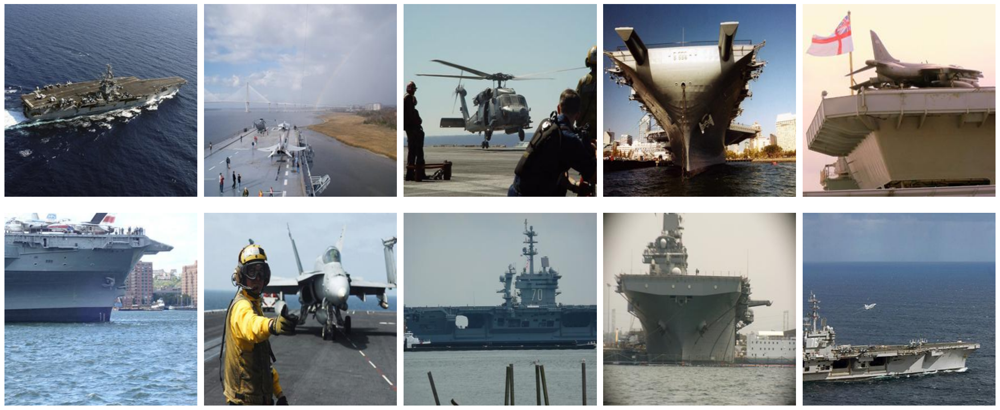

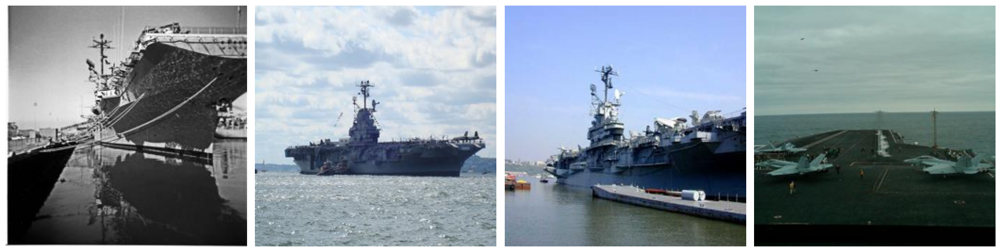

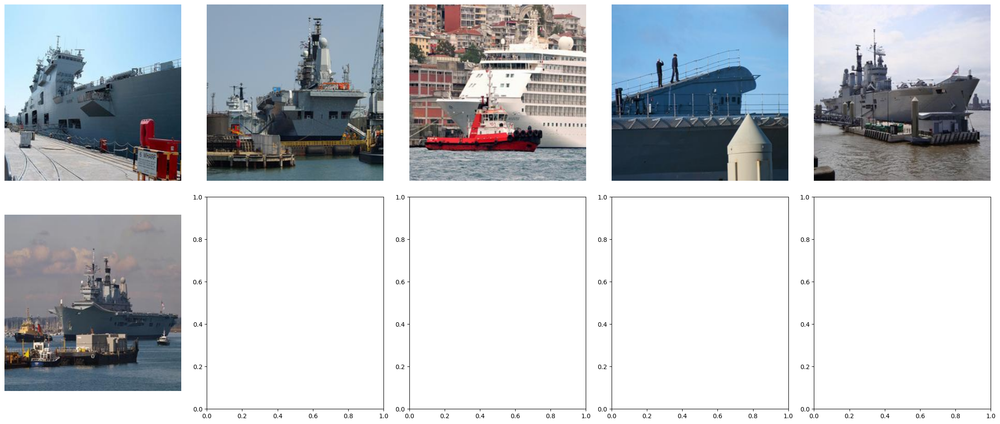

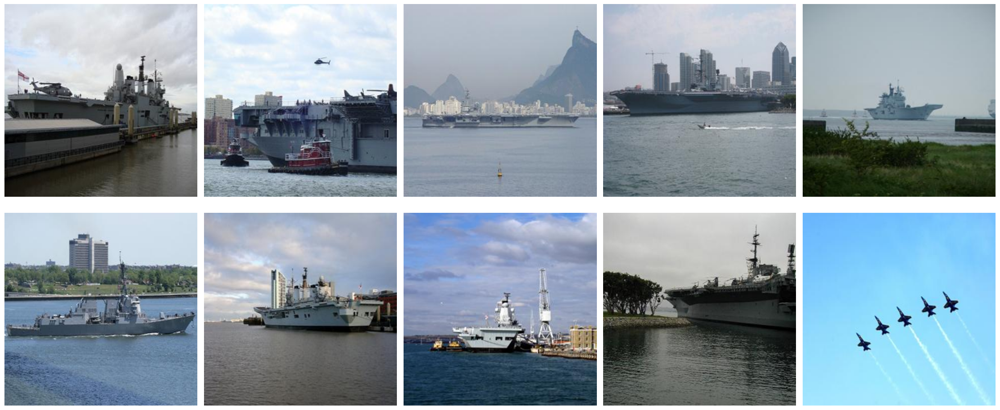

In [53]:
selected_class = 403
for type in ["prototype", "confounded", "shortcut", "ambiguous"]:
    key = f"{type}_indices"
    indices = out[key][test_labels[out[key]] == selected_class]
    plot_group_images(dataset, indices, image_key="image", top_k=10)   


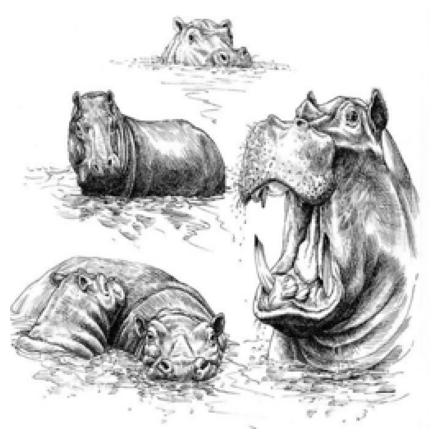

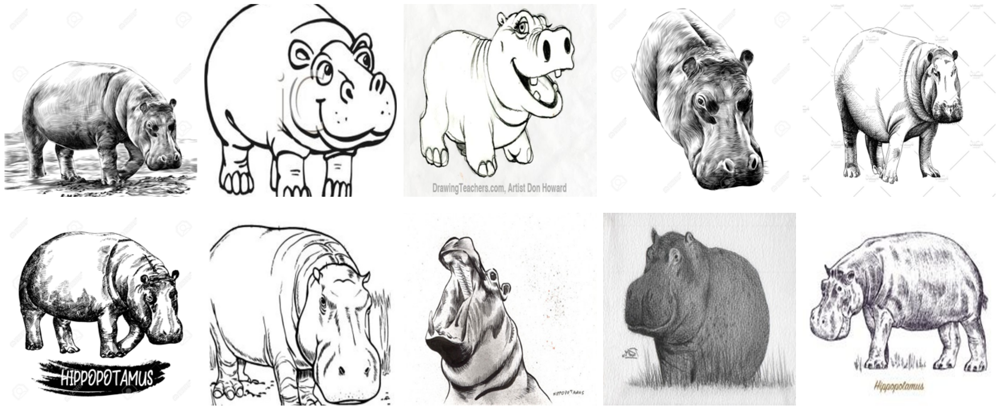

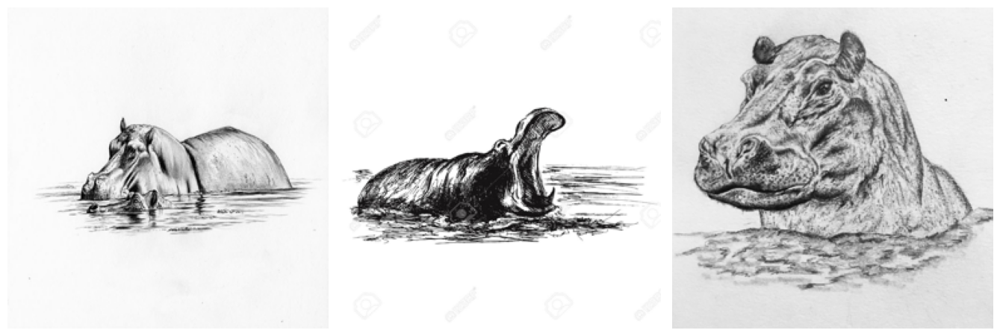

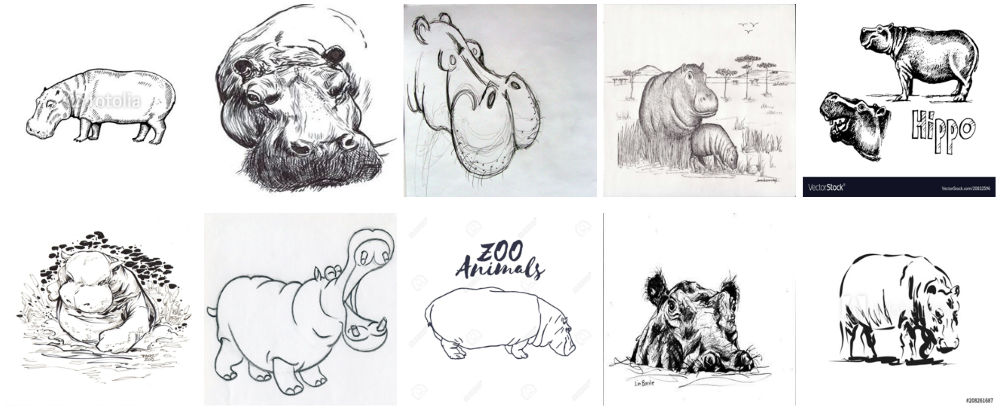

In [39]:
selected_class = 344
for type in ["prototype", "confounded", "shortcut", "ambiguous"]:
    key = f"{type}_indices"
    indices = out_diff_domain[key][test_diff_domain_labels[out_diff_domain[key]] == selected_class]
    plot_group_images(dataset_diff_domain, indices, image_key="image", top_k=10)   